In [97]:
import os
import numpy as np
import pickle
import pandas as pd
from scipy.stats import zscore
from brainbox.io.one import SessionLoader
from sklearn.preprocessing import StandardScaler
import gc
import concurrent.futures
import seaborn as sns
from matplotlib import pyplot as plt
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.decomposition import PCA

from functions import idxs_from_files, align_bin_design_matrix, states_per_trial_phase, broader_label, define_trial_types

from one.api import ONE
one = ONE(mode='remote')


In [2]:
prefix = '/home/ines/repositories/'
prefix = '/Users/ineslaranjeira/Documents/Repositories/'

In [3]:
extra_sessions = ['2d7c0f7f-e805-404b-914a-23d83998e08e',
'7691eeb3-715b-4571-8fda-6bb57aab8253',
'a28746ff-a6e0-403d-a11d-893c2f9a44b4',
'f140a2ec-fd49-4814-994a-fe3476f14e66',
'bd8b204f-a42e-45c1-a8f0-71c6223a6657',
'e4fac833-d985-4bb2-a97a-c4d7ed8d06e1',
'13b70283-e8d3-4e69-ae3f-83f50c9602e2',
'e34ee0ad-3ad8-4faa-b4d5-c1cc0cf3b496',
'f3eeb2d4-87ce-49ae-8a74-21665f6f1536',
'd9f0c293-df4c-410a-846d-842e47c6b502',
'86f741b4-9dee-4c28-8ee9-49f3656ab419',
'650a0a90-4bf3-4489-9bcd-75baf0a49eac',
'a2be3311-de26-48b3-bfc7-317e94a4fdd3',
'12f95449-6914-4d76-9eb3-7d79757a4a77',
'd9907ac3-7378-471d-91fb-c8ec34870e17',
'b4a8ec28-46ad-4b6f-908b-650d0970a0db',
'c51f34d8-42f6-4c9c-bb5b-669fd9c42cd9',
'71963e7f-5947-4c3e-bcc8-dfdef3d71be7',
'7471a326-894d-4b55-8b01-a0ad56af209c',
'8839a67d-991a-4694-9c45-b3af73ce4d36',
'db4fe6df-b1d2-4958-9c93-e71696d58f7f',
'80653a5b-c7aa-479d-9ae0-c92f296fface',
'169c9a39-cb63-4b77-93e2-10e076d4c472',
'495bee7e-b58e-42ea-8481-4a1bfedca54a',
'1db57661-5ad3-4465-b9ee-08473af9c2e8',
'3513e7f2-d2e6-4411-8055-54dac50458f6',
'd035c5ba-d51e-49a9-a94b-23531a598ec3',
'6a369bfa-a70b-4147-af25-d03772ff8d96',
'7050ae29-a99e-43f1-aa42-b4416200351c',
'3fa080ff-bcce-43e8-bd5f-601f0591f785',
'369c3073-e886-4b28-a32b-a5860df21392',
'aa8c915b-cc12-4022-8339-3faa438d7fe2',
'8b422ab2-fc98-4d25-ac1f-e239ca869d9e',
'87d86bb0-72d3-4213-be72-392295d3d601',
'2ab80a04-96f6-45f8-bf69-7eac67f81742',
'57701dff-8107-4ab6-ac7a-b087a2e4cc94',
'42541dce-2ffb-452e-bf54-119aee2ae48a',
'89848cb4-77d3-4db2-877e-2fa73a3cf5f6',
'33cbe984-deb7-489c-add6-d98ac9f64df6',
'0b5f5111-5647-4400-8e08-f57975027b5e',
'9e77877d-6fcf-4e91-9337-4b19277561d5',
'dc36f1b9-5dba-49c4-b333-ad08af6b8f86',
'8a039e2b-637e-45ed-8da6-0641924626f0',
'00d3c9ea-2c91-44c2-b03e-6dfec5e08f27',
'e698b903-98ed-48b9-bc40-664274f722da',
'e5094e8a-cd54-43d4-8a7a-c5aa54b15e19',
'09137957-7216-40ea-90b5-ef85a62b578a',
'03f0ed7f-e647-4732-ae1a-d41fc459138b',
'4373de88-6b08-4185-a224-f898fd0017d4',
'30c4e2ab-dffc-499d-aae4-e51d6b3218c2',
'1e07df0b-205b-4c94-8e02-2ae07dae4347',
'5c7d2345-1f0e-40e5-aad7-2c6133b71b09',
'1735d2be-b388-411a-896a-60b01eaa1cfe',
'14736609-bfdd-4620-8e47-09d7f4bc4412',
'4537bd9a-0a63-4462-870c-5f6d70d289ed',
'1715d2bc-4da3-4de2-9631-3ab1c600f2bf',
'aed404ce-b3fb-454b-ac43-2f12198c9eaf',
'f115196e-8dfe-4d2a-8af3-8206d93c1729',
'5c454bcb-ae77-42da-a8d2-b6463ea9f21b',
'c728f6fd-58e2-448d-aefb-a72c637b604c',
'c8fc81e8-fd09-4228-a08c-81c01f21381a',
'7502ae93-7437-4bcd-9e14-d73b51193656',
'297bd519-78f8-45d2-af85-835e865e228f',
'7b074b1a-6576-4380-91e4-ad6cdf06c3a6',
'064a7252-8e10-4ad6-b3fd-7a88a2db5463']

In [4]:
sessions_to_exclude = ['2d7c0f7f-e805-404b-914a-23d83998e08e', # bad right cam
'7691eeb3-715b-4571-8fda-6bb57aab8253', # bad view of paws
'bd8b204f-a42e-45c1-a8f0-71c6223a6657', # bad right camera
'f3eeb2d4-87ce-49ae-8a74-21665f6f1536', # moving licks
'650a0a90-4bf3-4489-9bcd-75baf0a49eac', # licks fail
'495bee7e-b58e-42ea-8481-4a1bfedca54a', # timestamps
'1db57661-5ad3-4465-b9ee-08473af9c2e8', # timestamps
'6a369bfa-a70b-4147-af25-d03772ff8d96', # timestamps
'7050ae29-a99e-43f1-aa42-b4416200351c', # timestamps
'3fa080ff-bcce-43e8-bd5f-601f0591f785', # timestamps
'5c454bcb-ae77-42da-a8d2-b6463ea9f21b', # bad licks
'c728f6fd-58e2-448d-aefb-a72c637b604c' # no data can be loaded
]

In [160]:
sessions_to_process = [x for x in extra_sessions if x not in sessions_to_exclude]

In [163]:
# Loop through animals
data_path = prefix + 'representation_learning_variability/paper-individuality/data/design_matrices/extra_bwm/'
all_files = os.listdir(data_path)
design_matrices = [item for item in all_files if 'design_matrix' in item and 'standardized' not in item]
idxs, mouse_names = idxs_from_files(design_matrices)

wheel_k = 3
paw_k = 8

paw_wavelet_path = prefix + 'representation_learning_variability/paper-individuality/data/paw_wavelets/extra_bwm/'
paw_states_path = prefix + 'representation_learning_variability/paper-individuality/data/paw_most_likely_states/'

wheel_wavelet_path = prefix + 'representation_learning_variability/paper-individuality/data/wheel_wavelets/extra_bwm/'
wheel_states_path = prefix + 'representation_learning_variability/paper-individuality/data/wheel_most_likely_states/'

In [164]:
paw_fix_mapping = {0:4, 1:1, 2:5, 3:7, 4:6, 5:2, 6:0, 7:3}
wheel_fix_mapping = {0:1, 1:0, 2:2} 

paw_func = np.vectorize(paw_fix_mapping.get)
wheel_func = np.vectorize(wheel_fix_mapping.get)

identifiable_mapping = {}

counter = 0
for wheel in [0, 1, 2]:
    for paw in range(8):
        key = f"{paw}{wheel}"
        identifiable_mapping[key] = float(counter)
        counter += 1
identifiable_mapping["nan"] = np.nan
identifiable_func = np.vectorize(identifiable_mapping.get)

In [44]:
all_sessions = pd.DataFrame()

for m, mat in enumerate(idxs):
    mouse_name = mat[37:]
    session = mat[:36]

    if session not in sessions_to_exclude:
        trials_file = data_path + "session_trials_" + str(session) + '_'  + mouse_name
        session_trials = pd.read_parquet(trials_file, engine='pyarrow').reset_index() 

        filename = data_path + "design_matrix_" + str(session) + '_'  + mouse_name
        design_matrix = pd.read_parquet(filename)
        design_matrix['paw_states'] = design_matrix['Bin'] * np.nan
        design_matrix['wheel_states'] = design_matrix['Bin'] * np.nan

        array = np.array(design_matrix[['Bin', 'avg_wheel_vel']]) 
        not_nan_wheel = ~np.isnan(array).any(axis=1)
        # Load wheel states 
        states_filename = wheel_states_path + "most_likely_states_" + str(wheel_k) + '_'  + mouse_name + session + '.npy'
        wheel_most_likely_states = np.load(open(states_filename, "rb"))
        assert len(wheel_most_likely_states) == len(design_matrix[not_nan_wheel])
        design_matrix['wheel_states'][not_nan_wheel] = wheel_func(wheel_most_likely_states)

        array = np.array(design_matrix[['Bin', 'l_paw_x', 'l_paw_y', 'r_paw_x', 'r_paw_y']]) 
        not_nan_paw = ~np.isnan(array).any(axis=1)
        # Load paw states
        states_filename = paw_states_path + "most_likely_states_" + str(paw_k) + '_'  + mouse_name + session + '.npy'
        paw_file = np.load(open(states_filename, "rb"))
        paw_most_likely_states = paw_file[0]
        paw_bins = paw_file[1]
        
        design_matrix.loc[design_matrix['Bin'].isin(paw_bins), 'paw_states'] = paw_func(paw_most_likely_states)

        design_matrix['mouse_name'] = mouse_name
        design_matrix['session'] = session

        design_matrix['identifiable_states'] = design_matrix['paw_states'].astype('Int64').astype(str) + design_matrix['wheel_states'].astype('Int64').astype(str)
        design_matrix['most_likely_states'] = identifiable_func(design_matrix['identifiable_states'])

        # Align bins
        multiplier = 1
        event_type_list = ['goCueTrigger_times']  # , 'feedback_times', 'firstMovement_times'
        event_type_name = ['Go cue']  # , 'Feedback time', 'First movement onset'
        init = -1 * multiplier
        end = 1.5 * multiplier
        empirical_data = align_bin_design_matrix(init, end, event_type_list, session_trials, design_matrix, design_matrix['most_likely_states'], multiplier)
        empirical_data = empirical_data.drop(columns=['new_bin'])
        
        """ Trial types """
        # Split in Foundtrial types
        states_trial = states_per_trial_phase(empirical_data, session_trials, multiplier)
        states_trial['mouse_name'] = mouse_name
        states_trial['session'] = session
        states_trial = broader_label(states_trial)
        states_trial = states_trial[['Bin',
                                    'correct', 'choice', 'contrast', 'block', 'reaction', 'response',
                                    'elongation', 'wsls', 'trial_id', 'goCueTrigger_times',
                                    'label', 'broader_label']]
        states_trial = states_trial.merge(design_matrix, on='Bin')
        all_sessions = pd.concat([all_sessions, states_trial])


/var/folders/nt/d2j3zp9d1xzb8wgfrw81j0c40000gn/T/ipykernel_13114/1260417478.py:22: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  design_matrix['wheel_states'][not_nan_wheel] = wheel_func(wheel_most_likely_states)
/var/folders/nt/d2j3zp9d1xzb

In [181]:
def add_most_likely_state(df, state_columns, new_column="left_paw_cameraL"):
    """
    df : pandas DataFrame
    state_columns : list of column names containing state probabilities
    new_column : name of output column
    """

    df[new_column] = df[state_columns].idxmax(axis=1)
    return df


In [182]:
var_left = ['leftCam_paw_r_still',  'leftCam_paw_r_move',  'leftCam_paw_r_wheel_turn',  'leftCam_paw_r_groom']
var_right = ['rightCam_paw_r_still',  'rightCam_paw_r_move',  'rightCam_paw_r_wheel_turn',  'rightCam_paw_r_groom']

new_df = add_most_likely_state(all_sessions, var_left, new_column="left_paw")
new_df = add_most_likely_state(all_sessions, var_right, new_column="right_paw")

In [183]:
fix_label = {'leftCam_paw_r_still':'still',  'leftCam_paw_r_move':'move',  'leftCam_paw_r_wheel_turn':'wheel',  'leftCam_paw_r_groom':'groom',
             'rightCam_paw_r_still':'still',  'rightCam_paw_r_move':'move',  'rightCam_paw_r_wheel_turn':'wheel',  'rightCam_paw_r_groom':'groom'} 

fix_label = {'leftCam_paw_r_still':'still',  'leftCam_paw_r_move':'move',  'leftCam_paw_r_wheel_turn':'move',  'leftCam_paw_r_groom':'groom',
             'rightCam_paw_r_still':'still',  'rightCam_paw_r_move':'move',  'rightCam_paw_r_wheel_turn':'move',  'rightCam_paw_r_groom':'groom'} 
label_func = np.vectorize(fix_label.get)
new_df['left_paw'] = label_func(new_df['left_paw'])
new_df['right_paw'] = label_func(new_df['right_paw'])

In [185]:
new_df['identifiable_action'] = new_df['left_paw'].astype(str) + new_df['right_paw'].astype(str)
new_df['most_likely_action'] = pd.factorize(new_df['identifiable_action'])[0]

# Syllable probability per epoch

In [429]:
trial_type_agg = ['correct_str', 'contrast_str', 'block_str', 'choice']
trial_type_agg = ['choice']

states_df = define_trial_types(new_df, trial_type_agg)

/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/paper-individuality/lightningAction/functions.py:374: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'correct' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  states_trial_type.loc[states_trial_type['correct_str']==1., 'correct_str'] = 'correct'


In [430]:
use_states = 'most_likely_states'  # most_likely_states most_likely_action

In [431]:
group_cols = ['mouse_name', 'session', 'broader_label', 'trial_type']
# Count syllables per group
data = (states_df.groupby(group_cols + [use_states]).size().reset_index(name='count'))
# Convert counts to fractions within each group
data['usage'] = (data['count'] /data.groupby(group_cols)['count'].transform('sum'))

In [432]:
design_df = data.pivot(index=['mouse_name', 'session', 'trial_type'], columns=['broader_label', use_states], values='usage').fillna(0).reset_index()

# LDA

## Leave-one-session-out CV

In [433]:
mouse_names = design_df['mouse_name']
trial_types = pd.factorize(design_df['trial_type'])[0]
mat = np.array(design_df)[:, 3:].astype(float)


Text(0, 0.5, 'Samples')

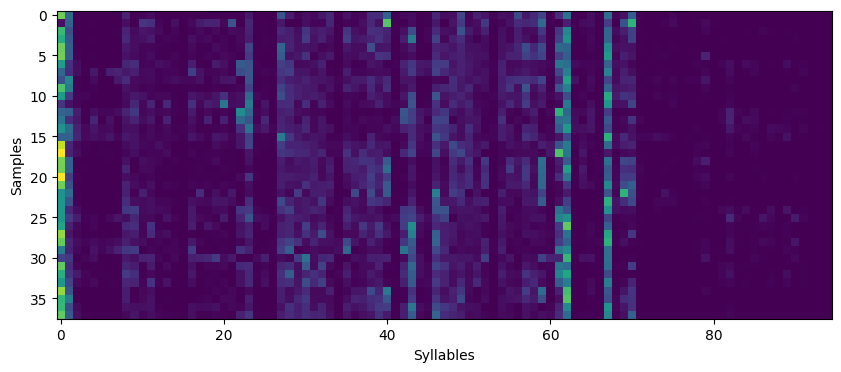

In [434]:
plt.figure(figsize=(10, 4))
plt.imshow(mat, aspect='auto', cmap='viridis', interpolation='none')
plt.xlabel('Syllables')
plt.ylabel('Samples')

Text(0.5, 1.0, 'Explained Variance by PCA')

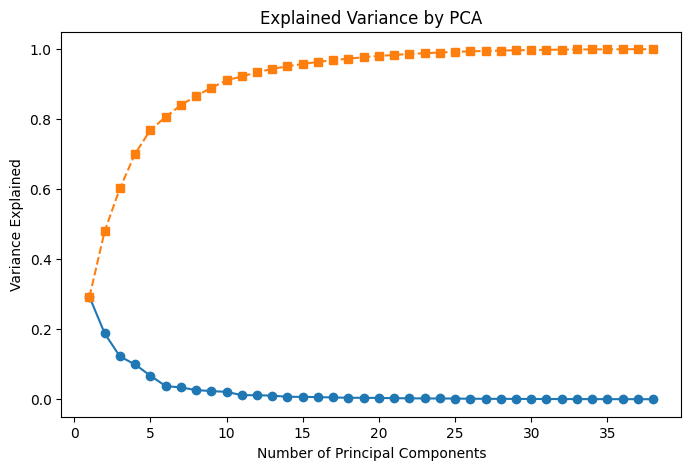

In [435]:
# PCA
n_components = np.min([np.shape(mat)[0], np.shape(mat)[1]])
# Step 1: Reduce dimensions with PCA
pca = PCA(n_components)  # Reduce to 50 dimensions
scaler = StandardScaler()
# standardized_X = scaler.fit_transform(np.array(session_syllables))
# X_pca = pca.fit_transform(standardized_X)
X_pca = pca.fit_transform(mat)

# Explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Plot explained variance
plt.figure(figsize=(8, 5))
plt.plot(range(1, n_components+1), explained_variance_ratio, marker='o', label='Individual')
plt.plot(range(1, n_components+1), cumulative_variance, marker='s', label='Cumulative', linestyle='--')
plt.xlabel("Number of Principal Components")
plt.ylabel("Variance Explained")
plt.title("Explained Variance by PCA")

In [436]:
min_components = np.where(cumulative_variance>0.95)[0][0]
print(min_components)

min_components = 36

13


In [437]:
use = np.array(X_pca[:, :min_components])
use = mat
scaler = StandardScaler()
norm_pop = scaler.fit_transform(use.copy())

In [438]:
trial_types

array([0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1,
       0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1])

In [439]:
n_per_mouse = 3
lda_components = 1
n_repeats = 10

final_matrix = np.array(norm_pop)
X = final_matrix.copy()
y = trial_types
n_samples = X.shape[0]

rng = np.random.default_rng(0)
# Store repeat results
true_scores_all = []
shuffle_scores_all = []

for repeat in range(n_repeats):
    scores_true = []
    scores_shuff = []

    # Subsample balanced sessions for training in each fold
    for test_idx in range(n_samples):

        X_test = X[test_idx:test_idx+1]
        y_test = y[test_idx:test_idx+1]

        train_idx = np.setdiff1d(np.arange(n_samples), test_idx)
        X_train_full = X[train_idx]
        y_train_full = y[train_idx]

        # # --- balanced subsampling for training ---
        # balanced_idx = []
        # for m in np.unique(y_train_full):
        #     m_idx = np.where(y_train_full == m)[0]
        #     if len(m_idx) >= n_per_mouse-1:
        #         balanced_idx.extend(rng.choice(m_idx, n_per_mouse-1, replace=False))
        #     # else:
        #         # print(m)

        # balanced_idx = np.array(balanced_idx)
        # X_train = X_train_full[balanced_idx]
        # y_train = y_train_full[balanced_idx]

        X_train = X_train_full
        y_train = y_train_full

        # --- true labels run ---
        lda = LinearDiscriminantAnalysis(
            priors=np.ones(len(np.unique(y_train))) / len(np.unique(y_train)),
            n_components=lda_components)
        lda.fit(X_train, y_train)
        scores_true.append(lda.score(X_test, y_test))

        # --- shuffled labels run ---
        y_train_shuff = y_train.copy()
        rng.shuffle(y_train_shuff)
        lda_shuff = LinearDiscriminantAnalysis(
            priors=np.ones(len(np.unique(y_train_shuff))) / len(np.unique(y_train_shuff)),
            n_components=lda_components)
        lda_shuff.fit(X_train, y_train_shuff)
        scores_shuff.append(lda_shuff.score(X_test, y_test))
        
    # store average score for this repeat
    true_scores_all.append(np.mean(scores_true))
    shuffle_scores_all.append(np.mean(scores_shuff))

print("True labels mean ± std:", np.mean(true_scores_all), np.std(true_scores_all))
print("Shuffled labels mean ± std:", np.mean(shuffle_scores_all), np.std(shuffle_scores_all))


True labels mean ± std: 0.4473684210526316 0.0
Shuffled labels mean ± std: 0.4973684210526315 0.07667790675964985


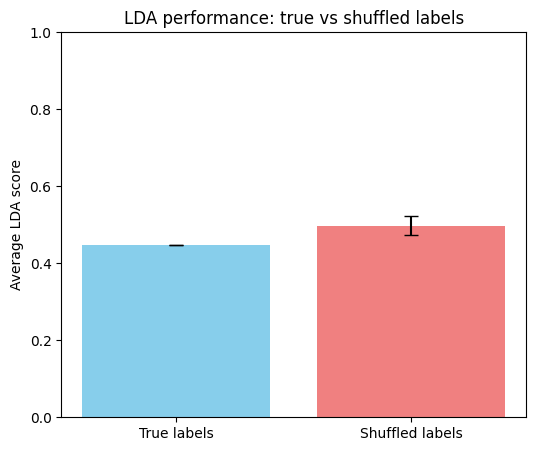

In [440]:
# Convert to arrays for convenience
true_scores = np.array(true_scores_all)
shuffle_scores = np.array(shuffle_scores_all)

# Compute means and standard deviations
means = [np.mean(true_scores), np.mean(shuffle_scores)]
stds  = [np.std(true_scores), np.std(shuffle_scores)]
std_errs = [np.std(true_scores)/np.sqrt(len(true_scores)), 
            np.std(shuffle_scores)/np.sqrt(len(shuffle_scores))]

labels = ['True labels', 'Shuffled labels']

# Create bar plot with error bars
plt.figure(figsize=(6,5))
plt.bar(labels, means, yerr=std_errs, capsize=5, color=['skyblue','lightcoral'])
plt.ylabel('Average LDA score')
plt.title('LDA performance: true vs shuffled labels')
plt.ylim(0,1)
plt.show()
